In [9]:
from torchvision import datasets
from torch.utils.data import DataLoader
import torchvision
from matplotlib import pyplot as plt
import torch

In [10]:
from networks import Encoder, Decoder
from torchinfo import summary

In [ ]:
from torch.autograd.functional import jvp, vjp
def isometry_trace_loss(func, z, create_graph=True):

    bs = len(z)
    m = z.shape[1]

    v = torch.randn(z.size()).to(z)
    Jv = jvp(
        func, z, v=v, create_graph=create_graph)[1]
    print(Jv.shape)
    JTJv = (vjp(
        func, z, v=Jv, create_graph=create_graph)[1]).view(bs, -1)
    print(JTJv.shape)
    TrG2 = torch.sum(JTJv**2, dim=1)
    print(TrG2)
    return (((TrG2 / m) -1)**2).mean()

In [46]:
a = torch.randn((10, 400))
f = lambda x: x

In [47]:
isometry_trace_loss(f, a)

torch.Size([10, 400])
torch.Size([10, 400])
tensor([378.9617, 470.5670, 406.0284, 377.8380, 428.5736, 396.0317, 411.8560,
        369.3775, 387.3874, 402.3379])


tensor(0.0072)

In [16]:
a.shape

torch.Size([100, 400])

In [14]:
t = torch.cuda.get_device_properties(1).total_memory / (1024**3)
r = torch.cuda.memory_reserved(1) / (1024**3)
a = torch.cuda.memory_allocated(1) / (1024**3)
f = r-a  # free inside reserved
print(f'Total: {t} GB, Reserved: {r} GB, Allocated: {a} GB, Free inside reserved: {f} GB')

Total: 23.64971923828125 GB, Reserved: 0.0 GB, Allocated: 0.0 GB, Free inside reserved: 0.0 GB


In [5]:
from pynvml import *
nvmlInit()
h = nvmlDeviceGetHandleByIndex(1)
info = nvmlDeviceGetMemoryInfo(h)
print(f'total    : {info.total / (1024**3)} GB')
print(f'free     : {info.free / (1024**3)} GB')
print(f'used     : {info.used / (1024**3)} GB')

total    : 23.98828125 GB
free     : 12.9742431640625 GB
used     : 11.0140380859375 GB


In [4]:
a = torch.randn(4, 3, 64, 64)

In [5]:
a.dtype

torch.float32

In [6]:
a = torch.randn(4, 3, 64, 64)
def hshs(a):
    a = a.double()
    return a.mean()
b = hshs(a)

In [7]:
b = hshs(a)
b.dtype

torch.float64

In [8]:
latent_dim = 512
channels = 3
encoder = Encoder(gap_ch=1, z_dim=latent_dim, base_ch=32)
decoder = Decoder(gap_ch=1, z_dim=latent_dim, base_ch=32)

In [9]:
summary(encoder, input_size=(1, channels, 64, 64))

Layer (type:depth-idx)                   Output Shape              Param #
Encoder                                  [1, 512]                  --
├─ConvBNReLU: 1-1                        [1, 32, 64, 64]           --
│    └─Sequential: 2-1                   [1, 32, 64, 64]           --
│    │    └─Conv2d: 3-1                  [1, 32, 64, 64]           864
│    │    └─BatchNorm2d: 3-2             [1, 32, 64, 64]           64
│    │    └─ReLU: 3-3                    [1, 32, 64, 64]           --
├─ConvBNReLU: 1-2                        [1, 64, 32, 32]           --
│    └─Sequential: 2-2                   [1, 64, 32, 32]           --
│    │    └─Conv2d: 3-4                  [1, 64, 32, 32]           18,432
│    │    └─BatchNorm2d: 3-5             [1, 64, 32, 32]           128
│    │    └─ReLU: 3-6                    [1, 64, 32, 32]           --
├─ConvBNReLU: 1-3                        [1, 64, 32, 32]           --
│    └─Sequential: 2-3                   [1, 64, 32, 32]           --
│    │   

In [10]:
summary(decoder, input_size=(1, latent_dim), context={"bottleneck_hw": (16, 16), "orig_hw": (64, 64)})

Layer (type:depth-idx)                   Output Shape              Param #
Decoder                                  [1, 3, 64, 64]            32,832
├─ChannelUnPool: 1-1                     [1, 256, 16, 16]          --
│    └─Sequential: 2-1                   [1, 256, 16, 16]          --
│    │    └─Conv2d: 3-1                  [1, 256, 16, 16]          256
├─DeconvBNReLU: 1-2                      [1, 128, 32, 32]          --
│    └─Sequential: 2-2                   [1, 128, 32, 32]          --
│    │    └─ConvTranspose2d: 3-2         [1, 128, 32, 32]          524,288
│    │    └─BatchNorm2d: 3-3             [1, 128, 32, 32]          256
│    │    └─ReLU: 3-4                    [1, 128, 32, 32]          --
├─ConvBNReLU: 1-3                        [1, 128, 32, 32]          --
│    └─Sequential: 2-3                   [1, 128, 32, 32]          --
│    │    └─Conv2d: 3-5                  [1, 128, 32, 32]          147,456
│    │    └─BatchNorm2d: 3-6             [1, 128, 32, 32]          25

In [1]:
from data import CelebA
CelebA_dataset = CelebA(split='train', filter_categories=[(15, False), (20, True)]) #, filter_categories=[(15, False), (20, True)]
CelebA_dataset[0][0].shape

/home/dgalperi/anaconda3/envs/max/lib/python3.13/site-packages/torch/cuda/__init__.py:61: FutureWarning: The pynvml package is deprecated. Please install nvidia-ml-py instead. If you did not install pynvml directly, please report this to the maintainers of the package that installed pynvml for you.
  import pynvml  # type: ignore[import]


torch.Size([3, 224, 176])

In [3]:
len(CelebA_dataset)

59164

In [38]:
from data import CelebA_small
CelebA_small_dataset = CelebA_small(split='train', filter_categories=[(15, False), (20, True)]) #, filter_categories=[(15, False), (20, True)]
CelebA_small_dataset[0][0].shape

torch.Size([3, 64, 64])

In [39]:
len(CelebA_dataset)

59164

In [ ]:
from torch.utils.data import DataLoader

dataloader = DataLoader(CelebA_dataset, batch_size=32, shuffle=False, num_workers=4)
dataloader2 = DataLoader(CelebA_dataset, batch_size=32, shuffle=False, num_workers=1)
# dataloader2 = DataLoader(CelebA_small_dataset, batch_size=32, shuffle=False, num_workers=4)

In [8]:
for batch in dataloader:
    images, labels = batch

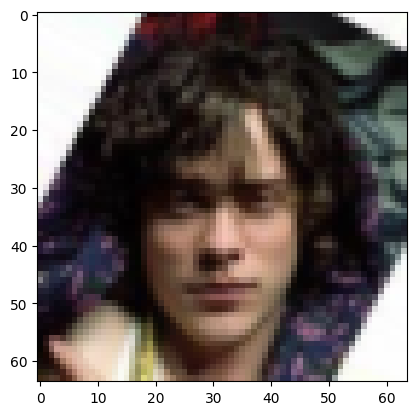

In [30]:
plt.imshow(images[1].permute(1, 2, 0))
plt.show()

In [6]:
for batch in dataloader2:
    images, labels = batch

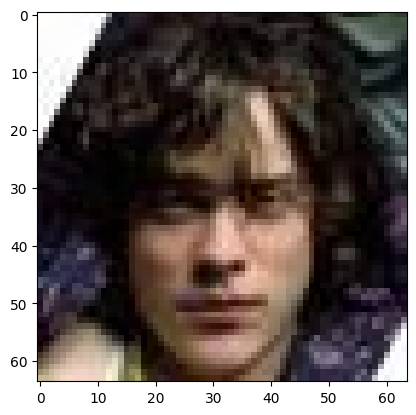

In [28]:
plt.imshow(images[1].permute(1, 2, 0))
plt.show()

In [8]:
from data import parse_celeba_attr_file

filenames, classnames, labels = parse_celeba_attr_file('data/CelebA/list_attr_celeba.txt')

In [12]:
print(labels)

{'000001.jpg': array([0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
       0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1], dtype=uint8), '000002.jpg': array([0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1], dtype=uint8), '000003.jpg': array([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1], dtype=uint8), '000004.jpg': array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1], dtype=uint8), '000005.jpg': array([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1], dtype=uint8), '000006.jpg': array([0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1], dtype=uint8), '000007.jpg': array([

In [14]:
lab = []
for l in labels.keys():
    # print(labels[l])
    lab.append(labels[l])

In [19]:
import numpy as np

In [20]:
lab = np.array(lab)

In [21]:
lab.shape

(202599, 40)

In [26]:
lab[:3]

array([[0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
        0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1],
       [0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
        0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
        0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1]],
      dtype=uint8)

In [27]:
lab = lab.transpose()

In [28]:
lab.sum(axis=1)

array([ 22516,  54090, 103833,  41446,   4547,  30709,  48785,  47516,
        48472,  29983,  10312,  41572,  28803,  11663,   9459,  13193,
        12716,   8499,  78390,  92189,  84434,  97942,   8417,  23329,
       169158,  57567,   8701,  56210,  16163,  13315,  11449,  97669,
        42222,  64744,  38276,   9818,  95715,  24913,  14732, 156734],
      dtype=uint64)

In [29]:
for i in range(len(classnames)):
    print(f"{classnames[i]}: {lab[i].sum()}")

5_o_Clock_Shadow: 22516
Arched_Eyebrows: 54090
Attractive: 103833
Bags_Under_Eyes: 41446
Bald: 4547
Bangs: 30709
Big_Lips: 48785
Big_Nose: 47516
Black_Hair: 48472
Blond_Hair: 29983
Blurry: 10312
Brown_Hair: 41572
Bushy_Eyebrows: 28803
Chubby: 11663
Double_Chin: 9459
Eyeglasses: 13193
Goatee: 12716
Gray_Hair: 8499
Heavy_Makeup: 78390
High_Cheekbones: 92189
Male: 84434
Mouth_Slightly_Open: 97942
Mustache: 8417
Narrow_Eyes: 23329
No_Beard: 169158
Oval_Face: 57567
Pale_Skin: 8701
Pointy_Nose: 56210
Receding_Hairline: 16163
Rosy_Cheeks: 13315
Sideburns: 11449
Smiling: 97669
Straight_Hair: 42222
Wavy_Hair: 64744
Wearing_Earrings: 38276
Wearing_Hat: 9818
Wearing_Lipstick: 95715
Wearing_Necklace: 24913
Wearing_Necktie: 14732
Young: 156734


In [31]:
# get index of "male" class
classnames.index("Male")

20

In [32]:
classnames.index("Eyeglasses")

15

In [25]:
data_path = 'data/CelebA/'
train_dataset = datasets.ImageFolder(
    root=data_path,
    transform=torchvision.transforms.ToTensor()
)
# create train test split
train_size = int(0.8 * len(train_dataset))
test_size = len(train_dataset) - train_size
generator = torch.Generator().manual_seed(36)
train_dataset, test_dataset = torch.utils.data.random_split(train_dataset, [train_size, test_size], generator=generator)

train_loader = DataLoader(
    train_dataset,
    batch_size=64,
    num_workers=1,
    shuffle=True
)

In [37]:
for batch in train_loader:
    images, labels = batch
    break

In [38]:
images.shape

torch.Size([64, 3, 218, 178])

In [29]:
len(train_dataset)

162079

In [28]:
labels.__len__()

31

In [15]:
train_dataset.labels

AttributeError: 'Subset' object has no attribute 'labels'

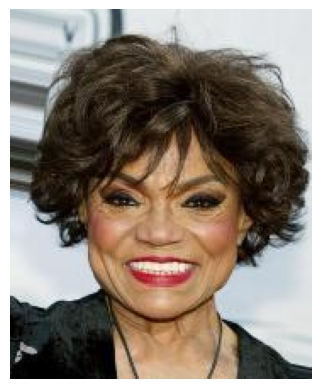

In [38]:
plt.imshow(train_dataset.__getitem__(1)[0].permute(1, 2, 0))
plt.axis('off')
plt.show()

In [21]:
train_dataset.__getitem__(1)

(tensor([[[0.2627, 0.2549, 0.2549,  ..., 0.2980, 0.3216, 0.3294],
          [0.2627, 0.2549, 0.2549,  ..., 0.2980, 0.3216, 0.3294],
          [0.2627, 0.2549, 0.2549,  ..., 0.2980, 0.3216, 0.3294],
          ...,
          [0.8275, 0.8667, 0.8667,  ..., 0.4824, 0.5451, 0.5725],
          [0.8902, 0.8706, 0.8431,  ..., 0.5412, 0.5569, 0.5412],
          [0.8902, 0.8706, 0.8431,  ..., 0.5529, 0.5647, 0.5451]],
 
         [[0.2039, 0.1961, 0.1961,  ..., 0.2863, 0.3098, 0.3176],
          [0.2039, 0.1961, 0.1961,  ..., 0.2863, 0.3098, 0.3176],
          [0.2039, 0.1961, 0.1961,  ..., 0.2863, 0.3098, 0.3176],
          ...,
          [0.8275, 0.8667, 0.8667,  ..., 0.3608, 0.4549, 0.5059],
          [0.8824, 0.8627, 0.8392,  ..., 0.4039, 0.4588, 0.4667],
          [0.8824, 0.8627, 0.8392,  ..., 0.4157, 0.4549, 0.4667]],
 
         [[0.1765, 0.1686, 0.1686,  ..., 0.2667, 0.2902, 0.2902],
          [0.1765, 0.1686, 0.1686,  ..., 0.2667, 0.2902, 0.2902],
          [0.1843, 0.1765, 0.1686,  ...,

In [1]:
from data import load_CelebA

In [4]:
train_dataset, test_dataset = load_CelebA("d", transform=[])

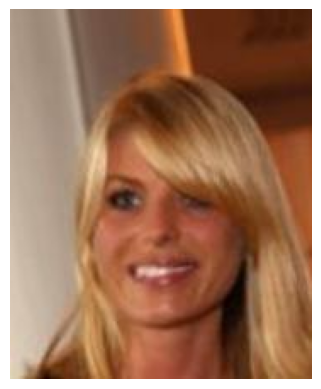

In [8]:
plt.imshow(test_dataset.__getitem__(1)[0].permute(1, 2, 0))
plt.axis('off')
plt.show()

In [ ]:
from pathlib import Path
import numpy as np

def parse_celeba_attr_file(path, to_zero_one=True, max_lines=None):
    """
    Parse CelebA `list_attr_celeba.txt`.

    Returns:
      filenames: list[str]                # filenames (e.g. '000001.jpg')
      classnames: list[str]               # attribute names (e.g. 'Smiling', ...)
      labels: np.ndarray (N, M) uint8/int8 # binary matrix (or -1/1 if to_zero_one=False)
    """
    path = Path(path)
    with path.open('r', encoding='utf-8') as f:
        # first line: number of images (we can ignore or use for validation)
        first = f.readline()
        try:
            total = int(first.strip())
        except ValueError:
            total = None

        # second line: attribute names
        header = f.readline().strip()
        classnames = header.split()
        M = len(classnames)

        filenames = []
        labels = {}
        for i, line in enumerate(f):
            if max_lines is not None and i >= max_lines:
                break
            parts = line.strip().split()
            if len(parts) == 0:
                continue
            fname = parts[0]
            vals = parts[1:]
            if len(vals) != M:
                # optionally skip, or raise. Here we raise to surface format problems.
                raise ValueError(f'Line {i+3} ({fname}) has {len(vals)} values, expected {M}')
            # convert to ints: -1/1 -> (0/1) if requested
            arr = np.array(vals, dtype=np.int8)
            if to_zero_one:
                arr = (arr == 1).astype(np.uint8)
            filenames.append(fname)
            labels[fname] = arr

    # labels = np.vstack(rows).astype(np.uint8 if to_zero_one else np.int8)
    return filenames, classnames, labels

# Example usage:
fnames, attrs, labels = parse_celeba_attr_file('data/CelebA/list_attr_celeba.txt')
print(len(fnames), 'images,', len(attrs), 'attributes')
print('attributes:', attrs)
print('labels shape:', labels.__len__())
print('first row (multi-hot):', labels[0])

202599 images, 40 attributes
attributes: ['5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace', 'Wearing_Necktie', 'Young']
labels shape: 202599


KeyError: 0

In [13]:
print(fnames[:100])

['000001.jpg', '000002.jpg', '000003.jpg', '000004.jpg', '000005.jpg', '000006.jpg', '000007.jpg', '000008.jpg', '000009.jpg', '000010.jpg', '000011.jpg', '000012.jpg', '000013.jpg', '000014.jpg', '000015.jpg', '000016.jpg', '000017.jpg', '000018.jpg', '000019.jpg', '000020.jpg', '000021.jpg', '000022.jpg', '000023.jpg', '000024.jpg', '000025.jpg', '000026.jpg', '000027.jpg', '000028.jpg', '000029.jpg', '000030.jpg', '000031.jpg', '000032.jpg', '000033.jpg', '000034.jpg', '000035.jpg', '000036.jpg', '000037.jpg', '000038.jpg', '000039.jpg', '000040.jpg', '000041.jpg', '000042.jpg', '000043.jpg', '000044.jpg', '000045.jpg', '000046.jpg', '000047.jpg', '000048.jpg', '000049.jpg', '000050.jpg', '000051.jpg', '000052.jpg', '000053.jpg', '000054.jpg', '000055.jpg', '000056.jpg', '000057.jpg', '000058.jpg', '000059.jpg', '000060.jpg', '000061.jpg', '000062.jpg', '000063.jpg', '000064.jpg', '000065.jpg', '000066.jpg', '000067.jpg', '000068.jpg', '000069.jpg', '000070.jpg', '000071.jpg', '0000

In [ ]:
import os
from pathlib import Path
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from sklearn.model_selection import train_test_split

class CelebA(Dataset):
    def __init__(self, transform=None, extensions=(".jpg",), test_size=0.2, split='train'):
        self.root_dir = Path("data/CelebA/img_align_celeba")

        if transform:
            self.transform = transform
        else:
            self.transform = transforms.Compose([
                transforms.ToTensor()
            ])

        labels = parse_celeba_attr_file('data/CelebA/list_attr_celeba.txt')[2]
        self.samples = []

        folder = self.root_dir
        for p in folder.rglob("*"):
            if p.is_file() and p.suffix.lower() in extensions:
                label = labels[p.name]
                self.samples.append((p, label))

        self.train_samples, self.test_samples = train_test_split(self.samples, test_size=test_size, random_state=42)

        if split == 'train':
            self.samples = self.train_samples
        else:
            self.samples = self.test_samples


    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        path, label = self.samples[idx]
        with Image.open(path) as im:
            # handle grayscale/alpha robustly
            if im.mode in ("RGBA", "LA"):
                im = im.convert("RGBA").convert("RGB")
            else:
                im = im.convert("RGB")
        if self.transform:
            im = self.transform(im)
        return im, label

# Example usage

ds = PNGFolderDataset(split='train')

In [31]:
len(ds)

162079

In [32]:
dataloader = DataLoader(ds, batch_size=64, shuffle=True)

In [33]:
for batch in dataloader:
    images, labels = batch

In [36]:
images.shape

torch.Size([31, 3, 218, 178])